Добрый день, меня зовут Кувакина Алсу. Рада предоставить сборный проект №1. 

Уважаемый ревьювер, прошу со всей строгостью проверять мой проект:)

# Закономерности успешности игры

Интернет-магазин «Стримчик» продаёт по всему миру компьютерные игры. Из открытых источников доступны исторические данные о продажах игр, оценки пользователей и экспертов, жанры и платформы (например, Xbox или PlayStation). Необходимо выявить определяющие успешность игры закономерности. Это позволит сделать ставку на потенциально популярный продукт и спланировать рекламные кампании.
   
Данные до 2016 года. Нужно отработать принцип работы с данными.
    
В наборе данных попадается аббревиатура ESRB (Entertainment Software Rating Board) — это ассоциация, определяющая возрастной рейтинг компьютерных игр. ESRB оценивает игровой контент и присваивает ему подходящую возрастную категорию, например, «Для взрослых», «Для детей младшего возраста» или «Для подростков».


Описание данных
* Name — название игры
* Platform — платформа
* Year_of_Release — год выпуска
* Genre — жанр игры
* NA_sales — продажи в Северной Америке (миллионы проданных копий)
* EU_sales — продажи в Европе (миллионы проданных копий)
* JP_sales — продажи в Японии (миллионы проданных копий)
* Other_sales — продажи в других странах (миллионы проданных копий)
* Critic_Score — оценка критиков (максимум 100)
* User_Score — оценка пользователей (максимум 10)
* Rating — рейтинг от организации ESRB (англ. Entertainment Software Rating Board). Эта ассоциация определяет рейтинг компьютерных игр и присваивает им подходящую возрастную категорию.


## Изучение данных из файла

Выгрузим файл, рассмотрим его каждый столбец и строку.

In [2]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
#pd.options.display.float_format = '{:.2f}'.format
# pd.set_option('display.max_columns', None)
# pd.set_option('display.max_rows', None)
import missingno as msno

In [2]:
df = pd.read_csv('games.csv', parse_dates=['Year_of_Release'])
df.head(5)

,Name,Platform,Year_of_Release,Genre,NA_sales,EU_sales,JP_sales,Other_sales,Critic_Score,User_Score,Rating
0,Wii Sports,Wii,2006.0,Sports,41.36,28.96,3.77,8.45,76.0,8,E
1,Super Mario Bros.,NES,1985.0,Platform,29.08,3.58,6.81,0.77,NaN,NaN,NaN
2,Mario Kart Wii,Wii,2008.0,Racing,15.68,12.76,3.79,3.29,82.0,8.3,E
3,Wii Sports Resort,Wii,2009.0,Sports,15.61,10.93,3.28,2.95,80.0,8,E
4,Pokemon Red/Pokemon Blue,GB,1996.0,Role-Playing,11.27,8.89,10.22,1.00,NaN,NaN,NaN


In [64]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16715 entries, 0 to 16714
Data columns (total 11 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Name             16713 non-null  object 
 1   Platform         16715 non-null  object 
 2   Year_of_Release  16446 non-null  object 
 3   Genre            16713 non-null  object 
 4   NA_sales         16715 non-null  float64
 5   EU_sales         16715 non-null  float64
 6   JP_sales         16715 non-null  float64
 7   Other_sales      16715 non-null  float64
 8   Critic_Score     8137 non-null   float64
 9   User_Score       10014 non-null  object 
 10  Rating           9949 non-null   object 
dtypes: float64(5), object(6)
memory usage: 1.4+ MB


In [58]:
df.describe()

,NA_sales,EU_sales,JP_sales,Other_sales,Critic_Score
count,16715.00,16715.00,16715.00,16715.00,8137.00
mean,0.26,0.15,0.08,0.05,68.97
std,0.81,0.50,0.31,0.19,13.94
min,0.00,0.00,0.00,0.00,13.00
25%,0.00,0.00,0.00,0.00,60.00
50%,0.08,0.02,0.00,0.01,71.00
75%,0.24,0.11,0.04,0.03,79.00
max,41.36,28.96,10.22,10.57,98.00


In [4]:
df.duplicated().sum()

0

In [5]:
df.isna().sum()

Name                  2
Platform              0
Year_of_Release     269
Genre                 2
NA_sales              0
EU_sales              0
JP_sales              0
Other_sales           0
Critic_Score       8578
User_Score         6701
Rating             6766
dtype: int64

Итак, у нас есть таблица из 16715 строк, без дубликатов, но с пропусками, также типа данных не соотвествует действительности, например, год выпуска Year_of_Release это object. 

## Предобработка данных

### Регистр

Заменим названия столбцов, т.е.приведем к нижнему регистру

In [31]:
pd.__version__

'1.2.4'

In [3]:
df = pd.read_csv('games.csv', parse_dates=['Year_of_Release'])
df.columns = map(str.lower, df.columns)
df['year_of_release'] = pd.to_datetime(df['year_of_release'], format='%Y.%M')

In [4]:
df.head(5)

,name,platform,year_of_release,genre,na_sales,eu_sales,jp_sales,other_sales,critic_score,user_score,rating
0,Wii Sports,Wii,2006-01-01,Sports,41.36,28.96,3.77,8.45,76.0,8,E
1,Super Mario Bros.,NES,1985-01-01,Platform,29.08,3.58,6.81,0.77,NaN,NaN,NaN
2,Mario Kart Wii,Wii,2008-01-01,Racing,15.68,12.76,3.79,3.29,82.0,8.3,E
3,Wii Sports Resort,Wii,2009-01-01,Sports,15.61,10.93,3.28,2.95,80.0,8,E
4,Pokemon Red/Pokemon Blue,GB,1996-01-01,Role-Playing,11.27,8.89,10.22,1.00,NaN,NaN,NaN


In [9]:
df[df['year_of_release'].isnull()].index.to_list()

[183,
 377,
 456,
 475,
 609,
 627,
 657,
 678,
 719,
 805,
 1131,
 1142,
 1301,
 1506,
 1538,
 1585,
 1609,
 1650,
 1699,
 1840,
 1984,
 2010,
 2106,
 2108,
 2132,
 2157,
 2169,
 2273,
 2281,
 2361,
 2453,
 2479,
 2492,
 2522,
 2536,
 2572,
 2773,
 2849,
 2969,
 3024,
 3081,
 3187,
 3223,
 3233,
 3289,
 3352,
 3413,
 3459,
 3486,
 3704,
 3739,
 3883,
 3997,
 4127,
 4132,
 4205,
 4220,
 4294,
 4337,
 4373,
 4437,
 4445,
 4635,
 4648,
 4775,
 4818,
 4848,
 4945,
 4959,
 5041,
 5070,
 5156,
 5194,
 5294,
 5326,
 5336,
 5443,
 5492,
 5588,
 5624,
 5642,
 5655,
 5769,
 5800,
 5857,
 5874,
 5889,
 5932,
 6019,
 6101,
 6133,
 6180,
 6199,
 6255,
 6266,
 6293,
 6299,
 6342,
 6356,
 6476,
 6624,
 6636,
 6773,
 6818,
 6861,
 6899,
 6954,
 6999,
 7008,
 7108,
 7210,
 7332,
 7353,
 7354,
 7367,
 7387,
 7391,
 7406,
 7584,
 7605,
 7724,
 7735,
 7848,
 8023,
 8067,
 8150,
 8151,
 8197,
 8212,
 8250,
 8260,
 8319,
 8364,
 8500,
 8547,
 8632,
 8680,
 8740,
 8884,
 8918,
 9043,
 9119,
 9151,
 9218,
 9

In [24]:
df.loc[180:185]

,name,platform,year_of_release,genre,na_sales,eu_sales,jp_sales,other_sales,critic_score,user_score,rating
180,Minecraft,PS3,2014-01-01,Misc,2.03,2.37,0.00,0.87,NaN,NaN,NaN
181,Assassin's Creed II,X360,2009-01-01,Action,3.11,1.55,0.08,0.51,90.0,8.8,M
182,Tomb Raider II,PS,1997-01-01,Action,2.30,2.46,0.20,0.28,85.0,NaN,T
183,Madden NFL 2004,PS2,2003-01-01,Sports,4.26,0.26,0.01,0.71,94.0,8.5,E
184,Tomodachi Life,3DS,2013-01-01,Simulation,0.97,2.11,1.90,0.24,NaN,NaN,NaN
185,New Super Mario Bros. U,WiiU,2012-01-01,Platform,2.30,1.34,1.27,0.32,84.0,8.1,E


In [13]:
df[df['name'] == 'Madden NFL 2004']

,name,platform,year_of_release,genre,na_sales,eu_sales,jp_sales,other_sales,critic_score,user_score,rating
183,Madden NFL 2004,PS2,NaT,Sports,4.26,0.26,0.01,0.71,94.0,8.5,E
1881,Madden NFL 2004,XB,2003-01-01,Sports,1.02,0.02,0.00,0.05,92.0,8.3,E
3889,Madden NFL 2004,GC,2003-01-01,Sports,0.40,0.10,0.00,0.01,94.0,7.7,E
5708,Madden NFL 2004,GBA,2003-01-01,Sports,0.22,0.08,0.00,0.01,70.0,6.6,E


In [ ]:
movies[(movies.duration >= 200) | (movies.genre == 'Drama')]

In [44]:
df[(df['name'] == 'Madden NFL 2004') | (df['year_of_release'] == '1985-01-01')].sort_values(by='year_of_release').tail(7).to_dict()

{'name': {374: 'Kung Fu',
  1971: 'Tag Team Match M.U.S.C.L.E.',
  15957: 'Strongest Tokyo University Shogi DS',
  1881: 'Madden NFL 2004',
  3889: 'Madden NFL 2004',
  183: 'Madden NFL 2004',
  5708: 'Madden NFL 2004'},
 'platform': {374: 'NES',
  1971: 'NES',
  15957: 'DS',
  1881: 'XB',
  3889: 'GC',
  183: 'PS2',
  5708: 'GBA'},
 'year_of_release': {374: Timestamp('1985-01-01 00:00:00'),
  1971: Timestamp('1985-01-01 00:00:00'),
  15957: Timestamp('1985-01-01 00:00:00'),
  1881: Timestamp('2003-01-01 00:00:00'),
  3889: Timestamp('2003-01-01 00:00:00'),
  183: Timestamp('2003-01-01 00:00:00'),
  5708: Timestamp('2003-01-01 00:00:00')},
 'genre': {374: 'Action',
  1971: 'Fighting',
  15957: 'Action',
  1881: 'Sports',
  3889: 'Sports',
  183: 'Sports',
  5708: 'Sports'},
 'na_sales': {374: 1.64,
  1971: 0.0,
  15957: 0.0,
  1881: 1.02,
  3889: 0.4,
  183: 4.26,
  5708: 0.22},
 'eu_sales': {374: 0.38,
  1971: 0.0,
  15957: 0.0,
  1881: 0.02,
  3889: 0.1,
  183: 0.26,
  5708: 0.08},
 

In [48]:
from pandas import Timestamp
from numpy import nan

In [56]:
df = pd.DataFrame({'name': {374: 'Kung Fu',  1971: 'Tag Team Match M.U.S.C.L.E.',  15957: 'Strongest Tokyo University Shogi DS',  1881: 'Madden NFL 2004',  3889: 'Madden NFL 2004',  183: 'Madden NFL 2004',  5708: 'Madden NFL 2004'}, 'platform': {374: 'NES',  1971: 'NES',  15957: 'DS',  1881: 'XB',  3889: 'GC',  183: 'PS2',  5708: 'GBA'}, 'year_of_release': {374: Timestamp('1985-01-01 00:00:00'),  1971: Timestamp('1985-01-01 00:00:00'),  15957: Timestamp('1985-01-01 00:00:00'),  1881: nan,  3889: Timestamp('2003-01-01 00:00:00'),  183: Timestamp('2003-01-01 00:00:00'),  5708: Timestamp('2003-01-01 00:00:00')}, 'genre': {374: 'Action',  1971: 'Fighting',  15957: 'Action',  1881: 'Sports',  3889: 'Sports',  183: 'Sports',  5708: 'Sports'}, 'na_sales': {374: 1.64,  1971: 0.0,  15957: 0.0,  1881: 1.02,  3889: 0.4,  183: 4.26,  5708: 0.22}, 'eu_sales': {374: 0.38,  1971: 0.0,  15957: 0.0,  1881: 0.02,  3889: 0.1,  183: 0.26,  5708: 0.08}, 'jp_sales': {374: 1.42,  1971: 1.05,  15957: 0.02,  1881: 0.0,  3889: 0.0,  183: 0.01,  5708: 0.0}, 'other_sales': {374: 0.06,  1971: 0.0,  15957: 0.0,  1881: 0.05,  3889: 0.01,  183: 0.71,  5708: 0.01}, 'critic_score': {374: nan,  1971: nan,  15957: nan,  1881: 92.0,  3889: 94.0,  183: 94.0,  5708: 70.0}, 'user_score': {374: nan,  1971: nan,  15957: nan,  1881: '8.3',  3889: '7.7',  183: '8.5',  5708: '6.6'},  'rating': {374: nan,  1971: nan,  15957: nan,  1881: 'E',  3889: 'E',  183: 'E',  5708: 'E'}})

df

,name,platform,year_of_release,genre,na_sales,eu_sales,jp_sales,other_sales,critic_score,user_score,rating
374,Kung Fu,NES,1985-01-01,Action,1.64,0.38,1.42,0.06,NaN,NaN,NaN
1971,Tag Team Match M.U.S.C.L.E.,NES,1985-01-01,Fighting,0.00,0.00,1.05,0.00,NaN,NaN,NaN
15957,Strongest Tokyo University Shogi DS,DS,1985-01-01,Action,0.00,0.00,0.02,0.00,NaN,NaN,NaN
1881,Madden NFL 2004,XB,NaT,Sports,1.02,0.02,0.00,0.05,92.0,8.3,E
3889,Madden NFL 2004,GC,2003-01-01,Sports,0.40,0.10,0.00,0.01,94.0,7.7,E
183,Madden NFL 2004,PS2,2003-01-01,Sports,4.26,0.26,0.01,0.71,94.0,8.5,E
5708,Madden NFL 2004,GBA,2003-01-01,Sports,0.22,0.08,0.00,0.01,70.0,6.6,E


In [54]:
# Составлю код для замены пропусков в годах по названию игры:
df_unique = df.loc[df['year_of_release'].notnull()].groupby('name').nth(0)
mapping = pd.Series(df_unique['year_of_release'].values, index=df_unique.index).to_dict()
df.loc[df['year_of_release'].isnull(), 'year_of_release'] = df['name'].map(mapping)

In [55]:
df

,name,platform,year_of_release,genre,na_sales,eu_sales,jp_sales,other_sales,critic_score,user_score,rating
374,Kung Fu,NES,1985-01-01,Action,1.64,0.38,1.42,0.06,NaN,NaN,NaN
1971,Tag Team Match M.U.S.C.L.E.,NES,1985-01-01,Fighting,0.00,0.00,1.05,0.00,NaN,NaN,NaN
15957,Strongest Tokyo University Shogi DS,DS,1985-01-01,Action,0.00,0.00,0.02,0.00,NaN,NaN,NaN
1881,Madden NFL 2004,XB,2003-01-01,Sports,1.02,0.02,0.00,0.05,92.0,8.3,E
3889,Madden NFL 2004,GC,2003-01-01,Sports,0.40,0.10,0.00,0.01,94.0,7.7,E
183,Madden NFL 2004,PS2,2003-01-01,Sports,4.26,0.26,0.01,0.71,94.0,8.5,E
5708,Madden NFL 2004,GBA,2003-01-01,Sports,0.22,0.08,0.00,0.01,70.0,6.6,E


In [15]:
df[df['name'] == 'Madden NFL 2004']

,name,platform,year_of_release,genre,na_sales,eu_sales,jp_sales,other_sales,critic_score,user_score,rating
183,Madden NFL 2004,PS2,2003-01-01,Sports,4.26,0.26,0.01,0.71,94.0,8.5,E
1881,Madden NFL 2004,XB,2003-01-01,Sports,1.02,0.02,0.00,0.05,92.0,8.3,E
3889,Madden NFL 2004,GC,2003-01-01,Sports,0.40,0.10,0.00,0.01,94.0,7.7,E
5708,Madden NFL 2004,GBA,2003-01-01,Sports,0.22,0.08,0.00,0.01,70.0,6.6,E


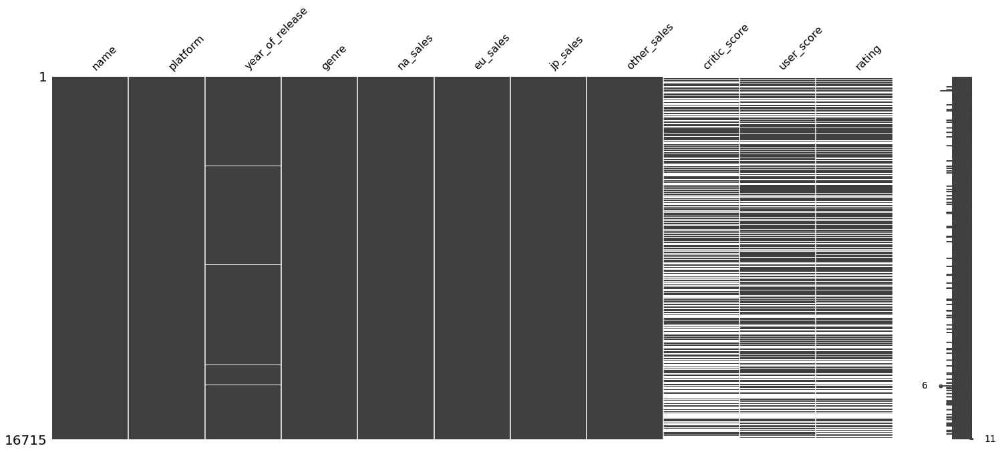

In [7]:
msno.matrix(df);

In [20]:
df_unique = df.loc[df['year_of_release'].notnull()].groupby('name').nth(0)
df_unique

,platform,year_of_release,genre,na_sales,eu_sales,jp_sales,other_sales,critic_score,user_score,rating
name,,,,,,,,,,
Beyblade Burst,3DS,2016-01-01,Role-Playing,0.00,0.00,0.03,0.00,NaN,NaN,NaN
Fire Emblem Fates,3DS,2015-01-01,Role-Playing,0.81,0.23,0.52,0.11,NaN,NaN,NaN
Frozen: Olaf's Quest,3DS,2013-01-01,Platform,0.27,0.27,0.00,0.05,NaN,NaN,NaN
Haikyu!! Cross Team Match!,3DS,2016-01-01,Adventure,0.00,0.00,0.04,0.00,NaN,NaN,NaN
Tales of Xillia 2,PS3,2012-01-01,Role-Playing,0.20,0.12,0.45,0.07,71.0,7.9,T
'98 Koshien,PS,1998-01-01,Sports,0.15,0.10,0.12,0.03,NaN,NaN,NaN
.hack//G.U. Vol.1//Rebirth,PS2,2006-01-01,Role-Playing,0.00,0.00,0.17,0.00,NaN,NaN,NaN
.hack//G.U. Vol.2//Reminisce,PS2,2006-01-01,Role-Playing,0.11,0.09,0.00,0.03,NaN,NaN,NaN
.hack//G.U. Vol.2//Reminisce (jp sales),PS2,2006-01-01,Role-Playing,0.00,0.00,0.16,0.00,NaN,NaN,NaN


In [21]:
df_unique.shape, df['name'].nunique()

((11426, 10), 11559)

In [22]:
mapping = pd.Series(df_unique['year_of_release'].values, index=df_unique.index).to_dict()
mapping

{' Beyblade Burst': Timestamp('2016-01-01 00:00:00'),
 ' Fire Emblem Fates': Timestamp('2015-01-01 00:00:00'),
 " Frozen: Olaf's Quest": Timestamp('2013-01-01 00:00:00'),
 ' Haikyu!! Cross Team Match!': Timestamp('2016-01-01 00:00:00'),
 ' Tales of Xillia 2': Timestamp('2012-01-01 00:00:00'),
 "'98 Koshien": Timestamp('1998-01-01 00:00:00'),
 '.hack//G.U. Vol.1//Rebirth': Timestamp('2006-01-01 00:00:00'),
 '.hack//G.U. Vol.2//Reminisce': Timestamp('2006-01-01 00:00:00'),
 '.hack//G.U. Vol.2//Reminisce (jp sales)': Timestamp('2006-01-01 00:00:00'),
 '.hack//G.U. Vol.3//Redemption': Timestamp('2007-01-01 00:00:00'),
 '.hack//Infection Part 1': Timestamp('2002-01-01 00:00:00'),
 '.hack//Link': Timestamp('2010-01-01 00:00:00'),
 '.hack//Mutation Part 2': Timestamp('2002-01-01 00:00:00'),
 '.hack//Outbreak Part 3': Timestamp('2002-01-01 00:00:00'),
 '.hack//Quarantine Part 4: The Final Chapter': Timestamp('2003-01-01 00:00:00'),
 '.hack: Sekai no Mukou ni + Versus': Timestamp('2012-01-01 00

In [23]:
df.loc[df['year_of_release'].isnull(), 'year_of_release'] = df['name'].map(mapping)
df

,name,platform,year_of_release,genre,na_sales,eu_sales,jp_sales,other_sales,critic_score,user_score,rating
0,Wii Sports,Wii,2006-01-01,Sports,41.36,28.96,3.77,8.45,76.0,8,E
1,Super Mario Bros.,NES,1985-01-01,Platform,29.08,3.58,6.81,0.77,NaN,NaN,NaN
2,Mario Kart Wii,Wii,2008-01-01,Racing,15.68,12.76,3.79,3.29,82.0,8.3,E
3,Wii Sports Resort,Wii,2009-01-01,Sports,15.61,10.93,3.28,2.95,80.0,8,E
4,Pokemon Red/Pokemon Blue,GB,1996-01-01,Role-Playing,11.27,8.89,10.22,1.00,NaN,NaN,NaN
5,Tetris,GB,1989-01-01,Puzzle,23.20,2.26,4.22,0.58,NaN,NaN,NaN
6,New Super Mario Bros.,DS,2006-01-01,Platform,11.28,9.14,6.50,2.88,89.0,8.5,E
7,Wii Play,Wii,2006-01-01,Misc,13.96,9.18,2.93,2.84,58.0,6.6,E
8,New Super Mario Bros. Wii,Wii,2009-01-01,Platform,14.44,6.94,4.70,2.24,87.0,8.4,E
9,Duck Hunt,NES,1984-01-01,Shooter,26.93,0.63,0.28,0.47,NaN,NaN,NaN


### Тип данных

Преобразуем данные в нужные типы. Мне кажется, надо выделить год выпуска из даты выпуска игры для дальнейшего анализа данных. 

In [66]:
df['year_of_release'] = pd.to_datetime(df['year_of_release'], format='%Y.%M')
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16715 entries, 0 to 16714
Data columns (total 11 columns):
 #   Column           Non-Null Count  Dtype         
---  ------           --------------  -----         
 0   name             16713 non-null  object        
 1   platform         16715 non-null  object        
 2   year_of_release  16446 non-null  datetime64[ns]
 3   genre            16713 non-null  object        
 4   na_sales         16715 non-null  float64       
 5   eu_sales         16715 non-null  float64       
 6   jp_sales         16715 non-null  float64       
 7   other_sales      16715 non-null  float64       
 8   critic_score     8137 non-null   float64       
 9   user_score       10014 non-null  object        
 10  rating           9949 non-null   object        
dtypes: datetime64[ns](1), float64(5), object(5)
memory usage: 1.4+ MB


In [68]:
df.head(5)

,name,platform,year_of_release,genre,na_sales,eu_sales,jp_sales,other_sales,critic_score,user_score,rating
0,Wii Sports,Wii,2006-01-01,Sports,41.36,28.96,3.77,8.45,76.00,8,E
1,Super Mario Bros.,NES,1985-01-01,Platform,29.08,3.58,6.81,0.77,NaN,NaN,NaN
2,Mario Kart Wii,Wii,2008-01-01,Racing,15.68,12.76,3.79,3.29,82.00,8.3,E
3,Wii Sports Resort,Wii,2009-01-01,Sports,15.61,10.93,3.28,2.95,80.00,8,E
4,Pokemon Red/Pokemon Blue,GB,1996-01-01,Role-Playing,11.27,8.89,10.22,1.00,NaN,NaN,NaN


In [69]:
df.isna().mean()

name              0.00
platform          0.00
year_of_release   0.02
genre             0.00
na_sales          0.00
eu_sales          0.00
jp_sales          0.00
other_sales       0.00
critic_score      0.51
user_score        0.40
rating            0.40
dtype: float64

In [10]:
df.head(3)

,name,platform,year_of_release,genre,na_sales,eu_sales,jp_sales,other_sales,critic_score,user_score,rating,year
0,Wii Sports,Wii,1970-01-01 00:00:00.000002006,Sports,41.36,28.96,3.77,8.45,76.00,8,E,1970.00
1,Super Mario Bros.,NES,1970-01-01 00:00:00.000001985,Platform,29.08,3.58,6.81,0.77,NaN,NaN,NaN,1970.00
2,Mario Kart Wii,Wii,1970-01-01 00:00:00.000002008,Racing,15.68,12.76,3.79,3.29,82.00,8.3,E,1970.00


Пропусков всего 2%. Рассмотрим их.

### Пропуски

In [71]:
df.isna().sum()

name                  2
platform              0
year_of_release     269
genre                 2
na_sales              0
eu_sales              0
jp_sales              0
other_sales           0
critic_score       8578
user_score         6701
rating             6766
dtype: int64

#### year_of_release

Всего 2% пропусков или 269 строк.

In [12]:
# Составлю код для замены пропусков в годах по названию игры:
df_unique = df.loc[df['year_of_release'].notnull()].groupby('name').nth(0)
mapping = pd.Series(df_unique['year_of_release'].values, index=df_unique.index).to_dict()
df.loc[df['year_of_release'].isnull(), 'year_of_release'] = df['name'].map(mapping)
df.isna().mean()

name              0.00
platform          0.00
year_of_release   0.01
genre             0.00
na_sales          0.00
eu_sales          0.00
jp_sales          0.00
other_sales       0.00
critic_score      0.51
user_score        0.40
rating            0.40
year              0.02
dtype: float64

In [11]:
# Составлю код для замены пропусков в годах по названию платформа:
#df_unique = df.loc[df['year_of_release'].notnull()].groupby('platform').nth(0)
#mapping = pd.Series(df_unique['year_of_release'].values, index=df_unique.index).to_dict()
#df.loc[df['year_of_release'].isnull(), 'year_of_release'] = df['platform'].map(mapping)
#df.isna().mean()

In [12]:
df['year'] = df['year_of_release'].dt.year
df.isna().mean()

name              0.00
platform          0.00
year_of_release   0.01
genre             0.00
na_sales          0.00
eu_sales          0.00
jp_sales          0.00
other_sales       0.00
critic_score      0.51
user_score        0.40
rating            0.40
year              0.01
dtype: float64

Пропуски в year_of_release/year пропали.

#### Аббревиатура 'tbd' 

In [13]:
df['user_score'].isna().sum()

6701

In [14]:
len(df.loc[df['user_score'] == 'tbd'])

2424

Из выкипедии tbd расшифровывается как to be determined - перевод "будет определен", соответственно между tbd и пропуском разницы в нашем случае нет. Но так как их 2424 in в столбце, то заменим их на Nan

In [15]:
df['user_score'] = df['user_score'].replace('tbd', np.nan)

**Вывод**

С целью исключения искажения информации, пропуски в рейтинге, оценке критиков и пользователей предлагаю оставить без изменений. 

#### Суммарные продажи

Посчитаем суммарные продажи во всех регионах и запишите их в отдельный столбец

In [21]:
df['total_sales'] = df['na_sales'] + df['eu_sales'] + df['jp_sales'] + df['other_sales']
df.head()

,name,platform,year_of_release,genre,na_sales,eu_sales,jp_sales,other_sales,critic_score,user_score,rating,year,total_sales
0,Wii Sports,Wii,1970-01-01 00:00:00.000002006,Sports,41.36,28.96,3.77,8.45,76.00,8,E,1970.00,82.54
1,Super Mario Bros.,NES,1970-01-01 00:00:00.000001985,Platform,29.08,3.58,6.81,0.77,nan,NaN,NaN,1970.00,40.24
2,Mario Kart Wii,Wii,1970-01-01 00:00:00.000002008,Racing,15.68,12.76,3.79,3.29,82.00,8.3,E,1970.00,35.52
3,Wii Sports Resort,Wii,1970-01-01 00:00:00.000002009,Sports,15.61,10.93,3.28,2.95,80.00,8,E,1970.00,32.77
4,Pokemon Red/Pokemon Blue,GB,1970-01-01 00:00:00.000001996,Role-Playing,11.27,8.89,10.22,1.00,nan,NaN,NaN,1970.00,31.38


## Исследовательский анализ данных

Посмотрим, сколько игр выпускалось в разные годы. Важны ли данные за все периоды?

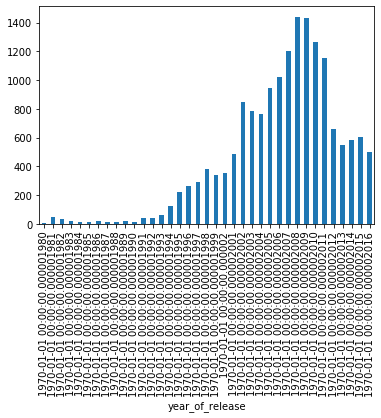

In [17]:
count_v_year = df.groupby('year_of_release')['name'].count()
count_v_year.plot(kind='bar')

Важны ли данные за все периоды?

In [20]:
df['year'].value_counts()

1970.00    16569
Name: year, dtype: int64

In [19]:
df.query('platform == "X360"')['year_of_release'].max()

Timestamp('1970-01-01 00:00:00.000002016')